In [1]:
import os
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from datetime import datetime
import seaborn as sns
from sklearn.cluster import DBSCAN
import pickle
import time
from sklearn.linear_model import LinearRegression
import random
import plotly.express as px
from plotly.subplots import make_subplots
import plotly.graph_objects as go

/opt/conda/lib/python3.7/site-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


In [2]:
def load_data(filename):
    a_file = open(filename, "rb")
    output = pickle.load(a_file)
    a_file.close()
    
    return output

def save_data(filename, data):
    a_file = open(filename, "wb")
    pickle.dump(data, a_file)
    a_file.close()

In [3]:
train_data = load_data('Processed_Data/train_set.pkl')
test_data = load_data('Processed_Data/test_set.pkl')

In [4]:
total_samples = 0
below = 0
mean_time = []
for traj in train_data:
    datetime = traj[2]
    total_samples += len(datetime)

    time_diff = np.array([t.seconds/60 for t in np.diff(np.array(datetime))])
    below += np.sum(time_diff < 30)
    
    mean_time.append(np.mean(time_diff))

In [5]:
below, total_samples, below/total_samples

(3516794, 3540044, 0.9934322850224461)

In [6]:
def fit_curve(times, feature, degree = 3, delta = 30):
    z = np.polyfit(times, feature, degree)
    f = np.poly1d(z)
    x_new = np.linspace(times[0], times[-1], (times[-1] + delta))
    y_new = f(x_new)
    
    return x_new, y_new

(1, 2.5)

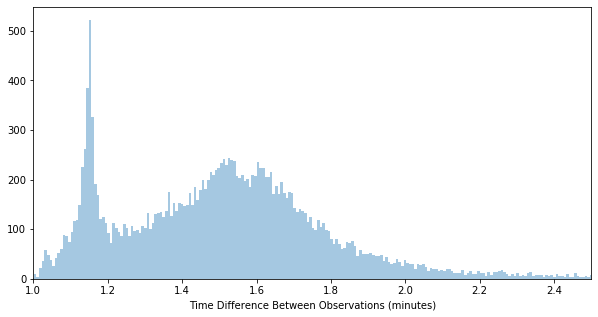

In [151]:
plt.figure(figsize = (10,5))
sns.distplot(mean_time, bins = 10000, kde = False)
plt.xlabel('Time Difference Between Observations (minutes)')
plt.xlim(right=2.5)
plt.xlim(left=1)

In [145]:
np.mean(np.array(mean_time)), np.std(np.array(mean_time))

(1.6126190282470827, 1.0812757035126088)

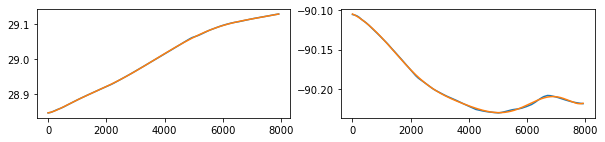

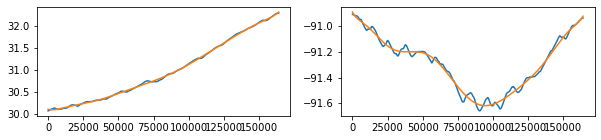

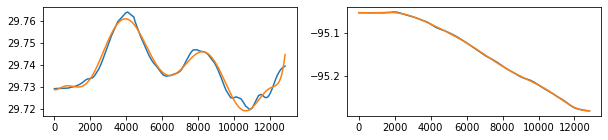

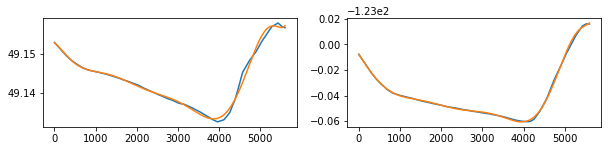

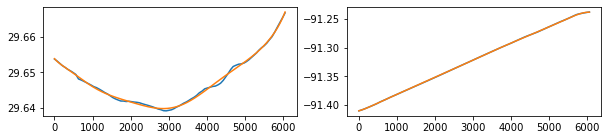

...

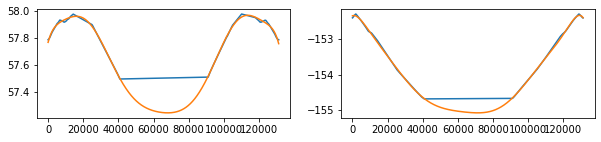

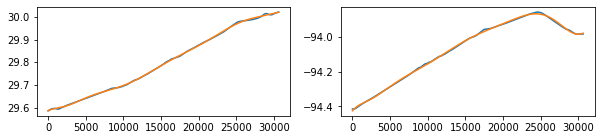

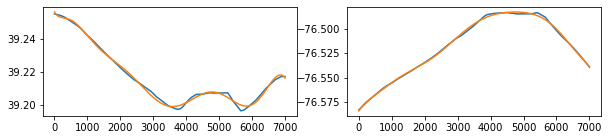

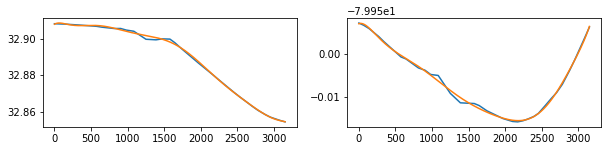

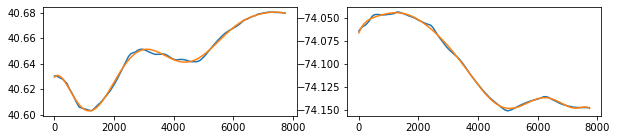

In [18]:
#MAKING PLOTS
total_samples = 0
below = 0
min_time = []
delta = 30
degree = 10

fig = make_subplots(rows=10, cols=2, start_cell="bottom-left")
for i, _ in enumerate(train_data):
    index = random.randint(0,len(train_data)-1)
    traj = train_data[index]
    long = np.array(traj[1])
    lat = np.array(traj[0])
    datetime = traj[2]
    
    time_diff = np.array([0] + [t.seconds for t in np.diff(np.array(datetime))])
    times = np.cumsum(time_diff)
    
    fig = plt.figure(figsize=(10,2))
    
    plt.subplot(1, 2, 1)
    plt.plot(times, lat)
    x_new, y_new = fit_curve(times, lat, degree = degree, delta = delta)
    plt.plot(x_new, y_new)
    
    plt.subplot(1, 2, 2)
    plt.plot(times, long)
    x_new, y_new = fit_curve(times, long, degree = degree, delta = delta)
    plt.plot(x_new, y_new)
    
    if i == 10:
        break

In [9]:
total_samples = 0
below = 0
min_time = []
delta = 30
fig = make_subplots(rows=7, cols=2, start_cell="bottom-left")
for i, _ in enumerate(train_data):
    index = random.randint(0,len(train_data)-1)
    traj = train_data[index]
    long = np.array(traj[1])
    lat = np.array(traj[0])
    datetime = traj[2]
    
    time_diff = np.array([0] + [t.seconds for t in np.diff(np.array(datetime))])
    times = np.cumsum(time_diff)
    
    
    
     
    fig.add_trace(go.Scatter(x=times, y=lat), row=i+1, col=1)
    x_new, y_new = fit_curve(times, lat, degree = 10, delta = 30)
    fig.add_trace(go.Scatter(x=x_new, y=y_new), row=i+1, col=1)
    
    fig.add_trace(go.Scatter(x=times, y=long), row=i+1, col=2)
    x_new, y_new = fit_curve(times, long, degree = 10, delta = 30)
    fig.add_trace(go.Scatter(x=x_new, y=y_new), row=i+1, col=2)
    
    
    if i == 6:
        break
        
fig.update_layout(height=1600, width=800, title_text="Side By Side Subplots")
fig.update_layout(title_text='Curve Fitted Trajectories', title_x=0.5)
fig.show()

In [101]:
for i, _ in enumerate(train_data):
    index = random.randint(0,len(train_data)-1)
    traj = train_data[index]
    lat = traj[0]
    long = traj[1]
    df = pd.DataFrame(
    {'latitude': lat,
     'longitude': long,
    })

    fig = px.line(df, x="latitude", y="longitude", width=700, height=700)
    fig.update_layout(title_text='Example Vessel Journey', title_x=0.5)
    fig.show()
    break

In [6]:
df = pd.DataFrame(
{'Context Size': [10,20,30,40,50,60,70,80,90,100,110,150, 200],
'Accuracy': [0,16.9,28.9,30,42.5,44.6,49.7, 51.8, 54.7, 55.6, 58.6, 61.1, 66.39],
})

fig = px.line(df, x="Context Size", y="Accuracy", width=700, height=700)
fig.update_layout(title_text='Accuracy vs Context Size', title_x=0.5)
fig.show()

In [2]:
len([10,20,30,40,50,60,70,80,90,100,110,150, 200])

13

In [3]:
len([0,16.9,28.9,30,42.5,44.6,49.7, 51.8, 54.7, 55.6, 58.6, 61.1])

12